## Import the libraries

In [2]:
# Import the libraries
import requests
from requests.auth import HTTPBasicAuth
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
from IPython.display import Image, HTML, display
import os
import json
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)

## Load and Inspect Data

### Using API to fetch the data

In [137]:
# Fetch the ACLED data using the GET request with the REST API 

# Define authentication details
api_key = "YOUR_API_KEY" # This will be availabe on your ACLED account
email = "YOUR_EMAIL" # Your email address that is linked to the ACLED account


url = f"https://api.acleddata.com/acled/read?key={api_key}&email={email}&country=Nigeria&event_date=2010-01-01|2024-12-31&event_date_where=BETWEEN&format=json"

#https://api.acleddata.com/acled/read?key={api_key}&email={email}

response = requests.get(
    url, auth=HTTPBasicAuth(api_key, email)
)

if response.status_code==200:
    print("The request was successful and the data has been fetched")
    # Parse the JSON response
    response_json = response.json()
else:
    print(f"Failed to fetch data. Status code: {response.status_code}")
    exit()

# Parse the JSON response
response_json = response.json()

# Extract the 'data' field which contains the actual events
data_list = response_json.get("data", [])

# Convert the list of events into a pandas DataFrame
data = pd.DataFrame(data_list)

# Display the first few rows of the DataFrame
data.head()

The request was successful and the data has been fetched
Empty DataFrame
Columns: [{"status":200, success:true, last_update:2, count:5000, messages:[], data:[{"event_id_cnty":"NIG36722", event_date:"2024-05-24", year:"2024", time_precision:"1", disorder_type:"Demonstrations", event_type:"Protests", sub_event_type:"Peaceful protest", actor1:"Protesters (Nigeria)", assoc_actor_1:"", inter1:"6", actor2:"", assoc_actor_2:"", inter2:"0", interaction:"60", civilian_targeting:"", iso:"566", region:"Western Africa", country:"Nigeria", admin1:"Federal Capital Territory", admin2:"Abuja Municipal", admin3:"", location:"Abuja", latitude:"9.0833", longitude:"7.5333", geo_precision:"1", source:"Daily Independent (Nigeria); Nigeria Punch; Sahara Reporters; Vanguard (Nigeria)", source_scale:"National-Regional", notes:"On 24 May 2024,  scores of protesters marched to the Aso Rock Presidential Villa and the National Assembly,  Abuja (Abuja Municipal,  FCT),  decrying the sacking of five Emirs and the re

In [150]:
# Display the DataFrame columns
print(data.columns)

Index(['event_id_cnty', 'event_date', 'year', 'time_precision',
       'disorder_type', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'civilian_targeting', 'iso', 'region', 'country',
       'admin1', 'admin2', 'admin3', 'location', 'latitude', 'longitude',
       'geo_precision', 'source', 'source_scale', 'notes', 'fatalities',
       'tags', 'timestamp'],
      dtype='object')


In [149]:
# Display the first few rows of the DataFrame
data.head()

,event_id_cnty,event_date,year,time_precision,disorder_type,event_type,sub_event_type,actor1,assoc_actor_1,inter1,...,location,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,tags,timestamp
0,NIG36722,2024-05-24,2024,1,Demonstrations,Protests,Peaceful protest,Protesters (Nigeria),,6,...,Abuja,9.0833,7.5333,1,Daily Independent (Nigeria); Nigeria Punch; Sa...,National-Regional,"On 24 May 2024, scores of protesters marched t...",0,crowd size=scores,1716850497
1,NIG36733,2024-05-24,2024,1,Political violence,Violence against civilians,Abduction/forced disappearance,Unidentified Armed Group (Nigeria),,3,...,Makurdi,7.7411,8.5121,1,Sahara Reporters,Regional,"On 24 May 2024, an unidentified armed group ab...",0,,1716850497
2,NIG36766,2024-05-24,2024,1,Political violence,Battles,Armed clash,Police Forces of Nigeria (2023-),,1,...,Ankpa,7.3706,7.6253,2,Daily Post (Nigeria),National,"On 24 May 2024, the police engaged a Kogi mili...",1,,1716850497
3,NIG36764,2024-05-23,2024,1,Political violence,Battles,Armed clash,Police Forces of Nigeria (2023-),Ajaokuta Communal Militia (Nigeria),1,...,Ajaokuta,7.4605,6.6947,1,Daily Post (Nigeria),National,"On 23 May 2024, the police and the Ajaokuta de...",0,,1716850497
4,NIG36782,2024-05-23,2024,1,Political violence,Violence against civilians,Attack,Fulani Ethnic Militia (Nigeria),Pastoralists (Nigeria),4,...,Makurdi,7.7411,8.5121,2,Nigeria Punch,National,"On 23 May 2024, suspected Fulani pastoralists ...",0,local administrators,1716850497


In [151]:
# Inspect Data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 31 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   event_id_cnty       5000 non-null   object
 1   event_date          5000 non-null   object
 2   year                5000 non-null   object
 3   time_precision      5000 non-null   object
 4   disorder_type       5000 non-null   object
 5   event_type          5000 non-null   object
 6   sub_event_type      5000 non-null   object
 7   actor1              5000 non-null   object
 8   assoc_actor_1       5000 non-null   object
 9   inter1              5000 non-null   object
 10  actor2              5000 non-null   object
 11  assoc_actor_2       5000 non-null   object
 12  inter2              5000 non-null   object
 13  interaction         5000 non-null   object
 14  civilian_targeting  5000 non-null   object
 15  iso                 5000 non-null   object
 16  region              5000

### Loading the data from your laptop

If you have the data in csv format on your laptop you can load the data using the code below

In [3]:
# Load the ACLED data from your computer
file_path = r"filepath.csv"

nga_data = pd.read_csv(file_path, encoding='utf-8')

C:\Users\legion\AppData\Local\Temp\ipykernel_58040\2929984764.py:4: DtypeWarning: Columns (29) have mixed types. Specify dtype option on import or set low_memory=False.
  nga_data = pd.read_csv(file_path, encoding='utf-8')


In [4]:
# Inspect the Data properties
nga_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32859 entries, 0 to 32858
Data columns (total 32 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   event_id_cnty       32859 non-null  object 
 1   event_date          32859 non-null  object 
 2   year                32859 non-null  int64  
 3   time_precision      32859 non-null  int64  
 4   disorder_type       32859 non-null  object 
 5   event_type          32859 non-null  object 
 6   sub_event_type      32859 non-null  object 
 7   actor1              32859 non-null  object 
 8   assoc_actor_1       9218 non-null   object 
 9   inter1              32859 non-null  int64  
 10  actor2              25209 non-null  object 
 11  assoc_actor_2       7800 non-null   object 
 12  inter2              32859 non-null  int64  
 13  interaction         32859 non-null  int64  
 14  civilian_targeting  12991 non-null  object 
 15  iso                 32859 non-null  int64  
 16  regi

In [5]:
# List the columns in the DataFrame
nga_data.columns

Index(['event_id_cnty', 'event_date', 'year', 'time_precision',
       'disorder_type', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'civilian_targeting', 'iso', 'region', 'country',
       'admin1', 'admin2', 'admin3', 'location', 'latitude', 'longitude',
       'geo_precision', 'source', 'source_scale', 'notes', 'fatalities',
       'tags', 'timestamp', 'population_best'],
      dtype='object')

In [6]:
# Check the first three rows of the DataFrame
nga_data.head(3)

,event_id_cnty,event_date,year,time_precision,disorder_type,event_type,sub_event_type,actor1,assoc_actor_1,inter1,...,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,tags,timestamp,population_best
0,NIG35728,29 March 2024,2024,2,Political violence,Explosions/Remote violence,Shelling/artillery/missile attack,MNJTF: Multinational Joint Task Force,Military Forces of Cameroon (1982-),8,...,11.0840,13.6925,2,Twitter,New media,"Around 29 March 2024 (as reported), the Camero...",0,NaN,1712100281,192805.0
1,NIG35733,29 March 2024,2024,1,Strategic developments,Strategic developments,Looting/property destruction,Police Forces of Nigeria (2023-),NaN,1,...,6.0127,7.2854,1,Daily Post (Nigeria),National,"Property destruction: On 29 March 2024, the Ni...",0,NaN,1712100281,NaN
2,NIG35711,28 March 2024,2024,2,Strategic developments,Strategic developments,Looting/property destruction,Military Forces of Nigeria (2023-),NaN,1,...,12.3377,14.1805,2,Twitter,New media,Property destruction: Around 28 March 2024 (as...,0,NaN,1712100281,NaN


In [7]:
# Check for null values in the columns/variables
nga_data.isnull().sum()

event_id_cnty             0
event_date                0
year                      0
time_precision            0
disorder_type             0
event_type                0
sub_event_type            0
actor1                    0
assoc_actor_1         23641
inter1                    0
actor2                 7650
assoc_actor_2         25059
inter2                    0
interaction               0
civilian_targeting    19868
iso                       0
region                    0
country                   0
admin1                    1
admin2                    1
admin3                32859
location                  0
latitude                  0
longitude                 0
geo_precision             0
source                    0
source_scale              0
notes                     0
fatalities                0
tags                  26198
timestamp                 0
population_best       14611
dtype: int64

In [8]:
# Check the spelling of the names of the states
# The analysis in this project is on the admin1 level
nga_data["admin1"].unique()

array(['Borno', 'Anambra', 'Plateau', 'Kwara', 'Ogun', 'Zamfara', 'Benue',
       'Federal Capital Territory', 'Rivers', 'Katsina', 'Imo', 'Ondo',
       'Ekiti', 'Akwa Ibom', 'Kogi', 'Kaduna', 'Nassarawa', 'Niger',
       'Yobe', 'Sokoto', 'Delta', 'Adamawa', 'Lagos', 'Edo', 'Ebonyi',
       'Bayelsa', 'Taraba', 'Bauchi', 'Osun', 'Oyo', 'Abia', 'Enugu',
       'Cross River', 'Jigawa', 'Kano', 'Kebbi', 'Gombe', nan],
      dtype=object)

In [9]:
# Check the row with missing value for state
nga_data["admin1"].isnull().sum()

1

In [10]:
# Remove the row with missing value for state
nga_data.dropna(subset = ["admin1"], inplace=True)

## Armed Clashes And Fatalities (2010 - 2023)

In [11]:
# Check the types of armed clash events in the data
nga_data["event_type"].unique()

array(['Explosions/Remote violence', 'Strategic developments', 'Protests',
       'Violence against civilians', 'Battles', 'Riots'], dtype=object)

In [12]:
# Check the 'sub_event_type' under 'Battles'
nga_data[nga_data["event_type"] == "Battles"]["sub_event_type"].unique()

array(['Armed clash', 'Government regains territory',
       'Non-state actor overtakes territory'], dtype=object)

In [13]:
# Subset the data based on events that are 'Battles'
nga_battles = nga_data[nga_data ["event_type"] == "Battles"]

In [14]:
# Take a further susbset based on 'Battles' that are 'Armed clash'
nga_armed = nga_battles[nga_battles['sub_event_type'] == "Armed clash"]
nga_armed.head(2)

,event_id_cnty,event_date,year,time_precision,disorder_type,event_type,sub_event_type,actor1,assoc_actor_1,inter1,...,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,tags,timestamp,population_best
8,NIG35725,27 March 2024,2024,1,Political violence,Battles,Armed clash,Military Forces of Nigeria (2023-),NaN,1,...,11.8316,7.0223,2,The Cable (Nigeria); Twitter,New media-National,"On 27 March 2024, the Nigerian troops clashed ...",0,NaN,1712100281,17406.0
10,NIG35727,27 March 2024,2024,1,Political violence,Battles,Armed clash,Military Forces of Nigeria (2023-),NaN,1,...,11.9555,6.9194,2,Daily Leadership (Nigeria); Legit,National,"On 27 March 2024, Nigerian troops engaged a Za...",21,NaN,1712100281,22751.0


In [15]:
# Filter the armed clasj events data to between 2010 - 2023
nga_armed_10_23 = nga_armed[(nga_armed["year"] >= 2010) & (nga_armed["year"] <= 2023)]
np.sort(nga_armed_10_23["year"].unique())  

array([2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020,
       2021, 2022, 2023], dtype=int64)

In [16]:
# Convert nga_armed_10_23 DataFrame to a GeoDataFrame
nga_armed_10_23_point = gpd.GeoDataFrame(
    nga_armed_10_23, 
    geometry = gpd.points_from_xy(nga_armed_10_23.longitude, nga_armed_10_23.latitude)
)

# Assign a CRS to the nga_armed_10_23
nga_armed_10_23_point.crs = "EPSG:4326"

# Visualize the nga_armed_10_23
nga_armed_10_23_point.explore()

### Aggregate Armed Clash and Fatalities

#### Q1. How does armed clash events and fatalities varies between 2010 and 2023?


In [34]:
# Group the susbset by 'year' and aggregate number of 'sub_event_type' and 'fatalities' to get the sum of armed clash events and fatalities in each YEAR between 2010 to 2023
nga_armed_fat_agg_yr = nga_armed_10_23.groupby(["year"]).agg({"sub_event_type":"count", "fatalities":"sum"}).reset_index()

# Rename the "sub_event_type" column
nga_armed_fat_agg_yr.rename(columns={"sub_event_type": "armed clash"}, inplace=True)
nga_armed_fat_agg_yr.head(14)

,year,armed clash,fatalities
0,2010,129,331
1,2011,68,435
2,2012,249,912
3,2013,300,2323
4,2014,272,3605
5,2015,205,2629
6,2016,266,1547
7,2017,352,1581
8,2018,424,2061
9,2019,588,2693


In [18]:
# Sort the year serially
nga_armed_fat_agg_yr_sort = nga_armed_fat_agg_yr.sort_values(by='year')

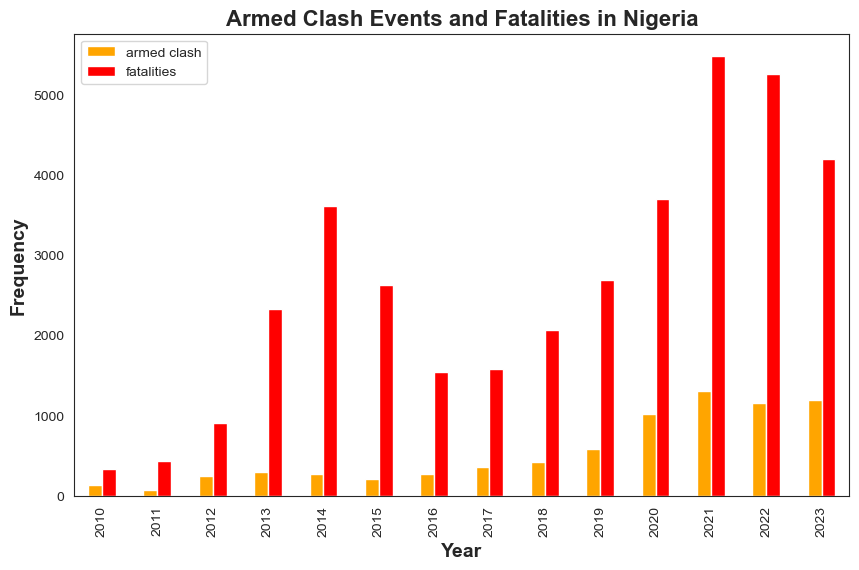

In [308]:
# Visualize the number of armed clash events and fatalities in each YEAR (2010 -2023) in Nigeria
fig, ax = plt.subplots(1, figsize=(10,6))

# Plot a grouped bar chart of the armed clash events and fatalities
nga_armed_fat_agg_yr_sort.plot(
    x="year",
    kind="bar",
    stacked=False,
    color= ["orange", "red"],
    ax=ax
)

plt.title("Armed Clash Events and Fatalities in Nigeria (2010 - 2023)", fontsize=16, fontweight="bold")
plt.xlabel("Year", fontsize=14, fontweight="bold")
plt.ylabel("Frequency", fontsize=14, fontweight="bold")

plt.legend();
fig.savefig("Maps_Images/Armed Conflicts_and_Fatalities_in_Nigeria__Python_Bar.png", transparent=True)

In [19]:
# Sort by "armed clash" and get the top 5 years with the highest armed clash events
armed_sort= nga_armed_fat_agg_yr.sort_values(by="armed clash", ascending=False)
armed_top_five= list(armed_sort["year"][:5])
armed_top_five

# Sort by "fatalities" and get the top 5 years with the highest fatalities
fatality_sort= nga_armed_fat_agg_yr.sort_values(by="fatalities", ascending=False)
fatality_top_five= list(fatality_sort["year"][:5])
fatality_top_five

# Convert the lists to comma-separated strings
armed_top_five_str = ", ".join(map(str, armed_top_five))
fatality_top_five_str = ", ".join(map(str, fatality_top_five))

print(f"The five highest numbers of armed clashes were in: {armed_top_five_str}")
print(f"The five highest numbers of deaths due to armed clashes were recorded in: {fatality_top_five_str}")


The five highest numbers of armed clashes were in: 2021, 2023, 2022, 2020, 2019
The five highest numbers of deaths due to armed clashes were recorded in: 2021, 2022, 2023, 2020, 2014


In [20]:
# Save/export the number of armed clashes and fatalities in each YEAR (2010 -2023) in Nigeria to a CSV file

# Create a directory to save the file
output_dir = "Processed" 

if not os.path.exists(output_dir):
    os.makedirs(output_dir)

file_name = "ACLED_nga_armed_fat_agg_yr.csv"
file_dir = os.path.join(output_dir, file_name)

# Save the file to CSV
nga_armed_fat_agg_yr.to_csv(file_dir)

#### Q2. Which States have experienced the most armed clash events and fatalities between 2010 and 2023?

In [105]:
# Group the susbset by "admin1" and aggregate number of "sub_event_type" and "fatalities" to get the sum of armed clash events and fatalities in each STATE between 2010 to 2023
nga_armed_fat_agg_st = nga_armed_10_23.groupby(["admin1"]).agg({"sub_event_type":"count", "fatalities":"sum"}).reset_index()

# Rename the "sub_event_type" column
nga_armed_fat_agg_st.rename(columns={"sub_event_type": "armed clash"}, inplace=True)
nga_armed_fat_agg_st.head(7)

,admin1,armed clash,fatalities
0,Abia,66,129
1,Adamawa,165,1644
2,Akwa Ibom,76,187
3,Anambra,214,431
4,Bauchi,71,305
5,Bayelsa,101,255
6,Benue,268,939


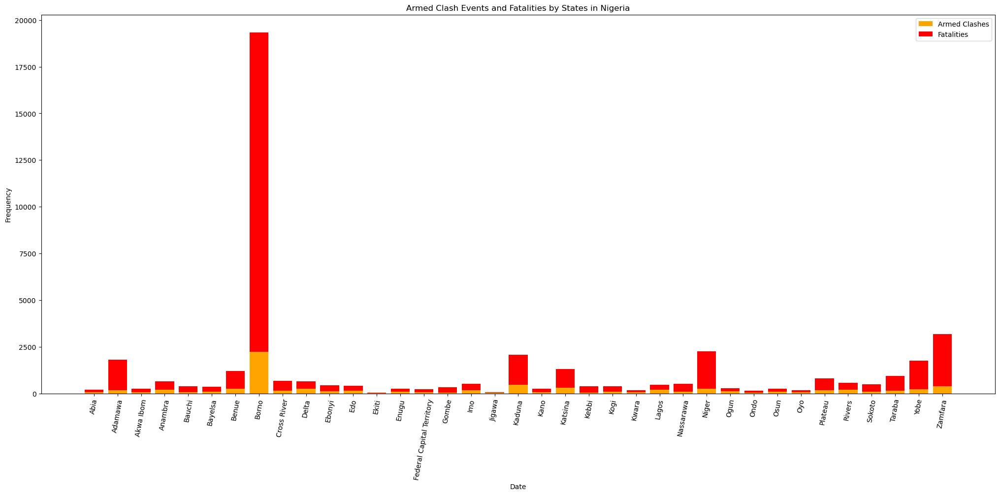

In [106]:
# Visualize the number of armed clashes and fatalities in each YEAR (2010 -2023) in Nigeria
fig, ax = plt.subplots(1, figsize=(25,10))

# Plotting armed clashes
ax.bar(nga_armed_fat_agg_st["admin1"], nga_armed_fat_agg_st["armed clash"], label="Armed Clashes", color="orange")

# Plot fatalities on top of armed clashes
ax.bar(nga_armed_fat_agg_st["admin1"], nga_armed_fat_agg_st["fatalities"], bottom=nga_armed_fat_agg_st["armed clash"], label="Fatalities", color="red")

plt.title("Armed Clash Events and Fatalities by States in Nigeria")
plt.xlabel("Date")
plt.ylabel("Frequency")

plt.legend()
plt.xticks(rotation=80);

In [107]:
# Sort by "armed clash" and get the top 5 states with the highest armed clash events
armed_st_sort= nga_armed_fat_agg_st.sort_values(by="armed clash", ascending=False)
armed_top_five_st = list(armed_st_sort["admin1"][:5])
armed_top_five_st

# Sort by "fatalities" and get the top 5 states with the highest fatalities
fatality_st_sort= nga_armed_fat_agg_st.sort_values(by="fatalities", ascending=False)
fatality_top_five_st= list(fatality_st_sort["admin1"][:5])
fatality_top_five_st

# Convert the lists to comma-separated strings
armed_top_five_st_str = ", ".join(map(str, armed_top_five_st))
fatality_top_five_st_str = ", ".join(map(str, fatality_top_five_st))

print(f"Top 5 States with the highest armed clash events: {armed_top_five_st_str}")
print(f"Top 5 States with the highest fatalities: {fatality_top_five_st_str}")

Top 5 States with the highest armed clash events: Borno, Kaduna, Zamfara, Katsina, Benue
Top 5 States with the highest fatalities: Borno, Zamfara, Niger, Adamawa, Kaduna


#### Q3. What is the correlation between the armed clash events and the fatalities?

In [108]:
# Check the correlation between armed clash events and fatalities
corr = nga_armed_fat_agg_yr["armed clash"].corr( nga_armed_fat_agg_yr["fatalities"])
corr

0.8775671067790397

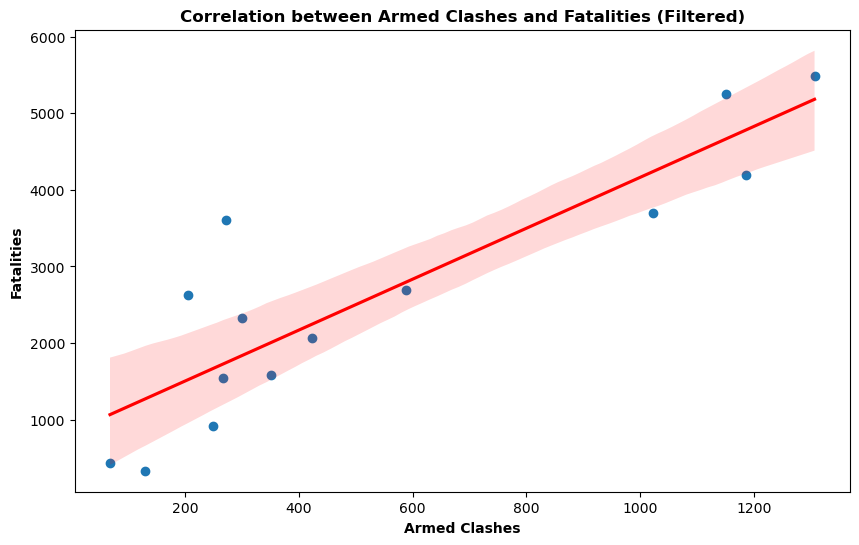

In [109]:
# Visualize the correlation

plt.figure(figsize=(10, 6))

plt.scatter(nga_armed_fat_agg_yr["armed clash"], nga_armed_fat_agg_yr["fatalities"])

# Adding a trend line
sns.regplot(data=nga_armed_fat_agg_yr, x="armed clash", y="fatalities", scatter=False, color="red")

# Add labels to the plot
plt.xlabel("Armed Clashes", fontweight="bold")
plt.ylabel("Fatalities", fontweight="bold")
plt.title("Correlation between Armed Clashes and Fatalities (Filtered)", fontweight="bold")
plt.show()

#### Q4.  Where are the highest concentration of armed clash events and fatalities? (Spatial Visualization)

In [110]:
# Load Nigeria adimn. level 1 boundary shapefile and view the columns
shp_pth = "Data/gadm41_NGA_shp/gadm41_NGA_1.shp"
nga_shp = gpd.read_file(shp_pth)

nga_shp.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 37 entries, 0 to 36
Data columns (total 12 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   GID_1      37 non-null     object  
 1   GID_0      37 non-null     object  
 2   COUNTRY    37 non-null     object  
 3   NAME_1     37 non-null     object  
 4   VARNAME_1  37 non-null     object  
 5   NL_NAME_1  37 non-null     object  
 6   TYPE_1     37 non-null     object  
 7   ENGTYPE_1  37 non-null     object  
 8   CC_1       37 non-null     object  
 9   HASC_1     37 non-null     object  
 10  ISO_1      37 non-null     object  
 11  geometry   37 non-null     geometry
dtypes: geometry(1), object(11)
memory usage: 3.6+ KB


In [111]:
# Check if the spelling of the names of the States/admin1 in nga_data is the same as in the admin. boundary shapefile
states_nga_armed = np.sort(nga_armed_fat_agg_st["admin1"].unique()) 
states_nga_shp = np.sort(nga_shp["NAME_1"].unique())

# Find if there is any different state spelling 
armed_not_in_shp = np.setdiff1d(states_nga_armed, states_nga_shp)
shp_not_in_armed = np.setdiff1d(states_nga_shp, states_nga_armed)

# Print the differences
print("States in nga_armed_fat_agg_st not in nga_shp:", armed_not_in_shp)
print("States in nga_shp not in nga_armed_fat_agg_st:", shp_not_in_armed)

States in nga_armed_fat_agg_st not in nga_shp: ['Nassarawa']
States in nga_shp not in nga_armed_fat_agg_st: ['Nasarawa']


In [112]:
# Correct the spelling error in nga_data
nga_armed_fat_agg_st["admin1"] = nga_armed_fat_agg_st["admin1"].replace("Nassarawa", "Nasarawa")

In [113]:
# Re-check if the spelling of the names of the States in nga_data is the same as the admin. boundary shapefile
np.sort(nga_armed_fat_agg_st["admin1"].unique()) == np.sort(nga_shp["NAME_1"].unique())

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True])

In [114]:
# Join the nga_armed_fat_agg_st Data Frame with the nga_shp shapefile
nga_armed_fat_agg_st_poly = nga_shp.merge(nga_armed_fat_agg_st, how = "left", left_on = "NAME_1", right_on ="admin1")
    
# Convert the polygons to point data
nga_armed_fat_agg_st_poly["centroid"] = nga_armed_fat_agg_st_poly.geometry.centroid
nga_armed_fat_agg_st_point = gpd.GeoDataFrame(nga_armed_fat_agg_st_poly, geometry="centroid")
    
#Drop the additional geometry column
nga_armed_fat_agg_st_point.drop(columns = "geometry", inplace=True)
    
nga_armed_fat_agg_st_point.columns

C:\Users\legion\AppData\Local\Temp\ipykernel_58040\1691473384.py:5: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




Index(['GID_1', 'GID_0', 'COUNTRY', 'NAME_1', 'VARNAME_1', 'NL_NAME_1',
       'TYPE_1', 'ENGTYPE_1', 'CC_1', 'HASC_1', 'ISO_1', 'admin1',
       'armed clash', 'fatalities', 'centroid'],
      dtype='object')

In [115]:
nga_armed_fat_agg_st_point.head()

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,admin1,armed clash,fatalities,centroid
0,NGA.1_1,NGA,Nigeria,Abia,NA,NA,State,State,NA,NG.AB,NG-AB,Abia,66,129,POINT (7.50914 5.45179)
1,NGA.2_1,NGA,Nigeria,Adamawa,NA,NA,State,State,NA,NG.AD,NG-AD,Adamawa,165,1644,POINT (12.44461 9.34400)
2,NGA.3_1,NGA,Nigeria,Akwa Ibom,NA,NA,State,State,NA,NG.AK,NG-AK,Akwa Ibom,76,187,POINT (7.83818 4.91230)
3,NGA.4_1,NGA,Nigeria,Anambra,NA,NA,State,State,NA,NG.AN,NG-AN,Anambra,214,431,POINT (6.93059 6.20822)
4,NGA.5_1,NGA,Nigeria,Bauchi,NA,NA,State,State,NA,NG.BA,NG-BA,Bauchi,71,305,POINT (9.98841 10.77564)


In [117]:
# Export the nga_armed_fat_agg_st_point

# Create a directory to save the files
output_dir = "Processed" 
if not os.path.exists(output_dir):
    os.mkdir(output_dir)

# select specific column to export
export = nga_armed_fat_agg_st_point[['COUNTRY', 'ISO_1', 'admin1', 'armed clash', 'fatalities', 'centroid']]

filename= os.path.join(output_dir, "ACLED_nga_armed_fat_agg_st_point.shp")
export.to_file(filename)

C:\Users\legion\AppData\Local\Temp\ipykernel_58040\500777868.py:12: UserWarning:

Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.



In [118]:
export.columns

Index(['COUNTRY', 'ISO_1', 'admin1', 'armed clash', 'fatalities', 'centroid'], dtype='object')

Visualize the spatial distribution of the armed clash events and fatalities with graduated symbols

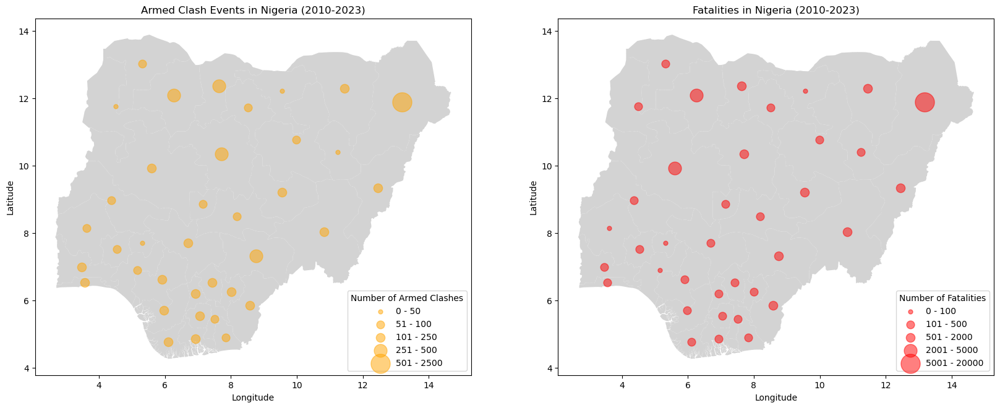

In [119]:
# Define the categorization function
def categorize(value, bins):
    for i, bin_range in enumerate(bins):
        if bin_range[0] <= value <= bin_range[1]:
            return i
    return len(bins)

# Define the ranges
armed_clash_bins = [(0, 50), (51, 100), (101, 250), (251, 500), (501, 2500)]
fatalities_bins = [(0, 100), (101, 500), (501, 2000), (2001, 5000), (5001, 20000)]

# Categorize the data
nga_armed_fat_agg_st_point["armed_clash_category"] = nga_armed_fat_agg_st_point["armed clash"].apply(lambda x: categorize(x, armed_clash_bins))
nga_armed_fat_agg_st_point["fatalities_category"] = nga_armed_fat_agg_st_point["fatalities"].apply(lambda x: categorize(x, fatalities_bins))

# Define the marker sizes for each category
armed_clash_sizes = [25, 85, 105, 225, 500]
fatalities_sizes = [25, 85, 105, 225, 500]

# Plot the maps
fig, axs = plt.subplots(1, 2, figsize=(20, 10))

# Plot base map
nga_shp.plot(ax=axs[0], color="lightgrey")
nga_shp.plot(ax=axs[1], color="lightgrey")

# Plot the distribution of armed clash events 
for i, size in enumerate(armed_clash_sizes):
    subset = nga_armed_fat_agg_st_point[nga_armed_fat_agg_st_point["armed_clash_category"] == i]
    subset.plot(ax=axs[0], color="orange", markersize=size, label=f"{armed_clash_bins[i][0]} - {armed_clash_bins[i][1]}", alpha=0.5)

axs[0].set_title("Armed Clash Events in Nigeria (2010-2023)")
axs[0].set_xlabel("Longitude")
axs[0].set_ylabel("Latitude")
axs[0].legend(title='Number of Armed Clashes', loc="lower right")

# Plot the distribution of fatalities 
for i, size in enumerate(fatalities_sizes):
    subset = nga_armed_fat_agg_st_point[nga_armed_fat_agg_st_point["fatalities_category"] == i]
    subset.plot(ax=axs[1], color="red", markersize=size, label=f"{fatalities_bins[i][0]} - {fatalities_bins[i][1]}", alpha=0.5)

axs[1].set_title("Fatalities in Nigeria (2010-2023)")
axs[1].set_xlabel("Longitude")
axs[1].set_ylabel("Latitude")
axs[1].legend(title="Number of Fatalities", loc="lower right")

plt.show()

Visualize the spatial distribution of the armed clash events and fatalities with interactive map

In [128]:
# Define the categorization function
def categorize(value, bins):
    for i, bin_range in enumerate(bins):
        if bin_range[0] <= value <= bin_range[1]:
            return i
    return len(bins)

# Define the ranges or graduated classification
armed_clash_bins = [(0, 50), (51, 100), (101, 250), (251, 500), (501, 2500)]
fatalities_bins = [(0, 100), (101, 500), (501, 2000), (2001, 5000), (5001, 20000)]

# Categorize the data
nga_armed_fat_agg_st_point["armed_clash_category"] = nga_armed_fat_agg_st_point["armed clash"].apply(lambda x: categorize(x, armed_clash_bins))
nga_armed_fat_agg_st_point["fatalities_category"] = nga_armed_fat_agg_st_point["fatalities"].apply(lambda x: categorize(x, fatalities_bins))

# Define the marker sizes for each category
armed_clash_sizes = [5, 10, 15, 20, 25]
fatalities_sizes = [5, 10, 15, 20, 25]

# Function to create a folium map with categorized data
def create_map(data, category_col, size_list, bins, map_title):
    # Create a base map 
    m = folium.Map(location=[9.0820, 8.6753], zoom_start=7)

    # Create a MarkerCluster object
    marker_cluster = MarkerCluster().add_to(m)

    # Add points to the base map with graduated sizes
    for idx, row in data.iterrows():
        size = size_list[row[category_col]]
        folium.CircleMarker(
            location=[row["centroid"].y, row["centroid"].x],
            radius=size,
            color="red",  # Set the color to red
            fill=True,
            fill_color="red",  # Set the fill color to red
            fill_opacity=0.6,
            popup=f"State: {row["admin1"]}<br>Clashes: {row["armed clash"]}<br>Fatalities: {row["fatalities"]}"
        ).add_to(marker_cluster)

    # Add a title
    title_html = f'''
         <h3 align="center" style="font-size:20px"><b>{map_title}</b></h3>
         '''
    m.get_root().html.add_child(folium.Element(title_html))

    return m

# Create the armed clashes map
armed_clash_map = create_map(
    data=nga_armed_fat_agg_st_point, 
    category_col="armed_clash_category", 
    size_list=armed_clash_sizes, 
    bins=armed_clash_bins, 
    map_title="Armed Clash Events in Nigeria (2010-2023)"
)
armed_clash_map.save("Maps_Images/armed_clash_map.html")

# Create the fatalities map
fatalities_map = create_map(
    data=nga_armed_fat_agg_st_point, 
    category_col="fatalities_category", 
    size_list=fatalities_sizes, 
    bins=fatalities_bins, 
    map_title="Fatalities in Nigeria (2010-2023)"
)
fatalities_map.save("Maps_Images/fatalities_map.html")


#### Q5. Does armed clash events exhibit seasonal variations? 

In [242]:
# Convert 'event_date' to datetime format
nga_armed_10_23['event_date'] = pd.to_datetime(nga_armed_10_23['event_date'], format='%d %B %Y')

C:\Users\legion\AppData\Local\Temp\ipykernel_38712\2033458994.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nga_armed_10_23['event_date'] = pd.to_datetime(nga_armed_10_23['event_date'], format='%d %B %Y')


In [243]:
# Verify the conversion
print(nga_armed_10_23["event_date"].dtype)

datetime64[ns]


In [246]:
# Extract year and month from 'event_date'
nga_armed_10_23["year"] = nga_armed_10_23["event_date"].dt.year
nga_armed_10_23["month"] = nga_armed_10_23["event_date"].dt.month

C:\Users\legion\AppData\Local\Temp\ipykernel_38712\859894795.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nga_armed_10_23['year'] = nga_armed_10_23['event_date'].dt.year
C:\Users\legion\AppData\Local\Temp\ipykernel_38712\859894795.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nga_armed_10_23['month'] = nga_armed_10_23['event_date'].dt.month


In [248]:
# Check the new columns that were added
print(nga_armed_10_23[["event_date", "year", "month"]].head())

     event_date  year  month
1330 2023-12-31  2023     12
1336 2023-12-31  2023     12
1337 2023-12-30  2023     12
1339 2023-12-30  2023     12
1341 2023-12-30  2023     12


In [250]:
# Aggregate data by year and month
monthly_events = nga_armed_10_23.groupby(["year", "month"]).size().reset_index(name='event_count')
monthly_events

,year,month,event_count
0,2010,1,26
1,2010,2,18
2,2010,3,18
3,2010,4,18
4,2010,5,7
...,...,...,...
163,2023,8,91
164,2023,9,79
165,2023,10,109
166,2023,11,113


In [251]:
# Pivot the data to have years as rows and months as columns
monthly_pivot = monthly_events.pivot(index='year', columns='month', values='event_count')
monthly_pivot

month,1,2,3,4,5,6,7,8,9,10,11,12
year,,,,,,,,,,,,
2010,26,18,18,18,7,7,6,7,2,5,3,12
2011,11,8,1,10,10,1,3,5,3,7,2,7
2012,10,18,26,18,11,31,19,24,19,20,28,25
2013,31,21,33,33,14,22,22,29,24,33,21,17
2014,15,15,26,23,25,32,24,28,24,13,14,33
2015,33,39,23,29,11,9,14,7,5,8,7,20
2016,20,17,24,31,20,23,32,13,23,21,28,14
2017,52,36,38,19,22,21,26,19,24,32,27,36
2018,22,40,19,47,47,46,28,33,25,33,36,48


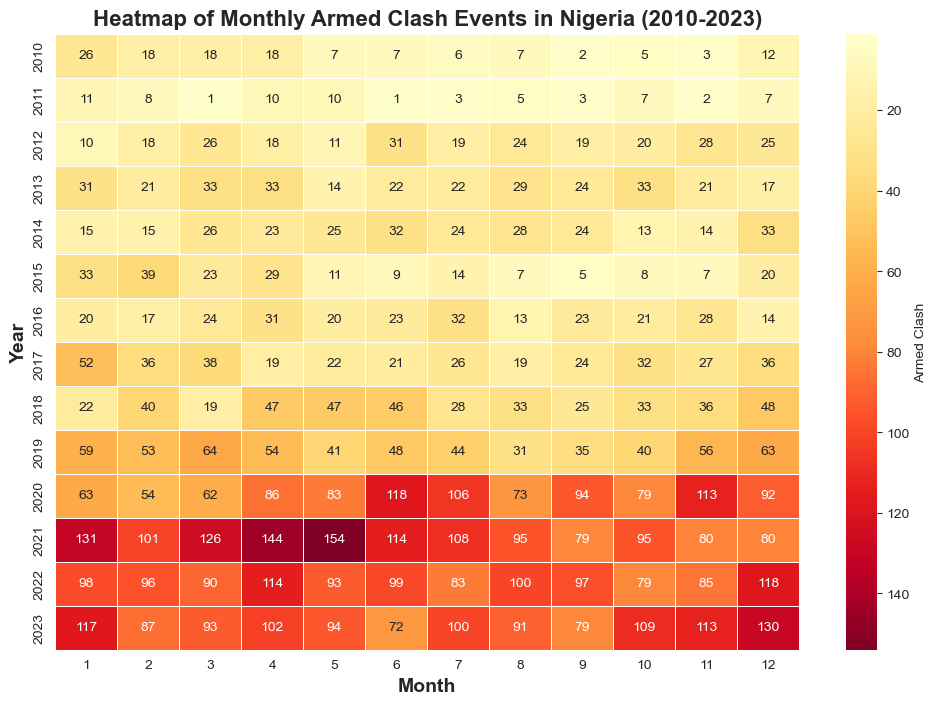

In [320]:
# Create a heatmap
plt.figure(figsize=(12, 8))
heatmap= sns.heatmap(monthly_pivot, cmap="YlOrRd", annot=True, fmt="d", linewidths=.5, cbar=reversed, cbar_kws={'label': 'Armed Clash'})
plt.title("Heatmap of Monthly Armed Clash Events in Nigeria (2010-2023)", fontsize=16, fontweight= "bold")
plt.xlabel("Month", fontsize=14, fontweight="bold")
plt.ylabel("Year", fontsize=14, fontweight = "bold")

# Invert the bar to be lowest at the top
heatmap.collections[0].colorbar.ax.invert_yaxis()

# Save the figure with a transparent background
plt.gcf().savefig("Maps_Images/Heatmap_of_Monthly_Armed_Clash_Events_in_Nigeria_Python.png", transparent=True)

#### Q6. Where are the overtaken territories?

##### Non-state Actor Overtakes Territory (2014 - 2022)

In [ ]:
# Check the sub_events under battle
nga_data[nga_data["event_type"] == "Battles"]["sub_event_type"].unique()

array(['Armed clash', 'Government regains territory',
       'Non-state actor overtakes territory'], dtype=object)

In [ ]:
# Take a susbset of the data to know the territory overtaken by non-state actor
nga_overtake_tertry = nga_battles[
    (nga_battles["sub_event_type"] == "Non-state actor overtakes territory") 
    & ((nga_battles["year"] >= 2014) & (nga_battles["year"] <= 2022))
]
nga_overtake_tertry.info()
nga_overtake_tertry.head(3)

<class 'pandas.core.frame.DataFrame'>
Index: 56 entries, 9439 to 29461
Data columns (total 32 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   event_id_cnty       56 non-null     object 
 1   event_date          56 non-null     object 
 2   year                56 non-null     int64  
 3   time_precision      56 non-null     int64  
 4   disorder_type       56 non-null     object 
 5   event_type          56 non-null     object 
 6   sub_event_type      56 non-null     object 
 7   actor1              56 non-null     object 
 8   assoc_actor_1       10 non-null     object 
 9   inter1              56 non-null     int64  
 10  actor2              56 non-null     object 
 11  assoc_actor_2       1 non-null      object 
 12  inter2              56 non-null     int64  
 13  interaction         56 non-null     int64  
 14  civilian_targeting  0 non-null      object 
 15  iso                 56 non-null     int64  
 16  region   

,event_id_cnty,event_date,year,time_precision,disorder_type,event_type,sub_event_type,actor1,assoc_actor_1,inter1,...,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,tags,timestamp,population_best
9439,NIG24487,10 April 2022,2022,2,Political violence,Battles,Non-state actor overtakes territory,Katsina Communal Militia (Nigeria),Zamfara Communal Militia (Nigeria),4,...,8.6707,10.3269,1,Daily Trust (Nigeria); Premium Times (Nigeria),National,"Around 10 April 2022 (as reported), around 200...",0,sexual violence,1702343238,1888.0
9440,NIG24488,10 April 2022,2022,2,Political violence,Battles,Non-state actor overtakes territory,Katsina Communal Militia (Nigeria),Zamfara Communal Militia (Nigeria),4,...,8.6333,10.7667,2,Daily Trust (Nigeria); Premium Times (Nigeria),National,"Around 10 April 2022 (as reported), around 200...",0,sexual violence,1702343238,39828.0
9441,NIG24489,10 April 2022,2022,2,Political violence,Battles,Non-state actor overtakes territory,Katsina Communal Militia (Nigeria),Zamfara Communal Militia (Nigeria),4,...,8.6396,10.5811,1,Daily Trust (Nigeria); Premium Times (Nigeria),National,"Around 10 April 2022 (as reported), around 200...",0,sexual violence,1702343238,975.0


In [ ]:
# Convert the subset of "overtaken territory" to a GeoDataFrame
nga_overtake_tertry_gdf = gpd.GeoDataFrame(
    nga_overtake_tertry, 
    geometry=gpd.points_from_xy(nga_overtake_tertry.longitude, nga_overtake_tertry.latitude)
    )

nga_overtake_tertry_gdf.columns 

Index(['event_id_cnty', 'event_date', 'year', 'time_precision',
       'disorder_type', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'civilian_targeting', 'iso', 'region', 'country',
       'admin1', 'admin2', 'admin3', 'location', 'latitude', 'longitude',
       'geo_precision', 'source', 'source_scale', 'notes', 'fatalities',
       'tags', 'timestamp', 'population_best', 'geometry'],
      dtype='object')

In [ ]:
# Check the CRS of the "overtaken territory" GeoDataFrame
print(nga_overtake_tertry_gdf.crs)

None


In [ ]:
# Assign WGS84 CRS to the "overtaken territory" GeoDataFrame
nga_overtake_tertry_gdf.crs = 'EPSG:4326'
nga_overtake_tertry_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
# Visualize the "overtaken territory"
nga_overtake_tertry_gdf["geometry"].explore() 

In [ ]:
# Save/export the "overtaken territory" GeoDataFrame into a shapefile
out_file = "ACLED_nga_overtaken_tertry_vector.shp"
filename = os.path.join(output_dir, out_file)

# Select columns to include in the output shapefile
nga_overtake_tertry_export = nga_overtake_tertry_gdf[[
       'year', 'disorder_type',  'sub_event_type', 'interaction', 'iso', 'region', 'country', 'admin1', 'admin2', 
       'admin3', 'location', 'latitude', 'longitude', 'fatalities', 'tags', 'geometry']]

nga_overtake_tertry_export.to_file(filename)

C:\Users\legion\AppData\Local\Temp\ipykernel_38712\2492744498.py:5: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  nga_overtake_tertry_gdf.to_file(filename)


In [ ]:
# Group the "overtaken territory" by year
nga_overtake_tertry_agg_yr = nga_overtake_tertry_gdf.groupby("year")["sub_event_type"].count()


# Convert the Series to DataFrame and rename the columns
nga_overtake_tertry_agg_yr = nga_overtake_tertry_agg_yr.reset_index()
nga_overtake_tertry_agg_yr.columns = ["year", "regain"]

nga_overtake_tertry_agg_yr.head(11)

,year,regain
0,2014,19
1,2015,6
2,2017,3
3,2018,10
4,2019,10
5,2021,3
6,2022,5


In [ ]:
# Save/export the grouped the "overtaken territory" by year into a csv file
file = os.path.join(output_dir, "ACLED_nga_overtaken_tertry_agg_yr.csv")
nga_overtake_tertry_agg_yr.to_csv(file)

#### Q7. Where are the regained territories by the government?

##### Government Regain Territory (2014 - 2022)

In [ ]:
# Take a susbset of the data to know the territory regained by the Government between 2014 AND 2022
nga_regain_tertry = nga_battles[
    (nga_battles["sub_event_type"] == "Government regains territory") 
    & (nga_battles["year"] >= 2014) & (nga_battles["year"] <= 2022)
]
nga_regain_tertry.info()
nga_regain_tertry.head(2)

<class 'pandas.core.frame.DataFrame'>
Index: 275 entries, 7500 to 29290
Data columns (total 32 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   event_id_cnty       275 non-null    object 
 1   event_date          275 non-null    object 
 2   year                275 non-null    int64  
 3   time_precision      275 non-null    int64  
 4   disorder_type       275 non-null    object 
 5   event_type          275 non-null    object 
 6   sub_event_type      275 non-null    object 
 7   actor1              275 non-null    object 
 8   assoc_actor_1       35 non-null     object 
 9   inter1              275 non-null    int64  
 10  actor2              275 non-null    object 
 11  assoc_actor_2       8 non-null      object 
 12  inter2              275 non-null    int64  
 13  interaction         275 non-null    int64  
 14  civilian_targeting  0 non-null      object 
 15  iso                 275 non-null    int64  
 16  region  

,event_id_cnty,event_date,year,time_precision,disorder_type,event_type,sub_event_type,actor1,assoc_actor_1,inter1,...,latitude,longitude,geo_precision,source,source_scale,notes,fatalities,tags,timestamp,population_best
7500,NIG26331,09 September 2022,2022,1,Political violence,Battles,Government regains territory,Military Forces of Nigeria (2015-2023),NaN,1,...,11.7196,7.0272,2,Blueprint; Sun (Nigeria),National,"On 9 September 2022, the air component of oper...",1,NaN,1710804491,26589.0
7899,NIG25938,06 August 2022,2022,1,Political violence,Battles,Government regains territory,Military Forces of Nigeria (2015-2023),Wase Communal Militia (Nigeria),1,...,9.2333,10.5667,2,Daily Independent (Nigeria); Nigeria Punch,National,"On 6 August 2022, Nigerian troops in a joint o...",8,NaN,1702343227,3969.0


In [ ]:
# Convert the subset of "Regained territory" to a GeoDataFrame
nga_regain_tertry_gdf = gpd.GeoDataFrame(
    nga_regain_tertry, 
    geometry=gpd.points_from_xy(nga_regain_tertry.longitude, nga_regain_tertry.latitude)
)

nga_regain_tertry_gdf.columns

Index(['event_id_cnty', 'event_date', 'year', 'time_precision',
       'disorder_type', 'event_type', 'sub_event_type', 'actor1',
       'assoc_actor_1', 'inter1', 'actor2', 'assoc_actor_2', 'inter2',
       'interaction', 'civilian_targeting', 'iso', 'region', 'country',
       'admin1', 'admin2', 'admin3', 'location', 'latitude', 'longitude',
       'geo_precision', 'source', 'source_scale', 'notes', 'fatalities',
       'tags', 'timestamp', 'population_best', 'geometry'],
      dtype='object')

In [ ]:
# Check the CRS of the "Regained territory" GeoDataFrame
print(nga_regain_tertry_gdf.crs)

None


In [ ]:
# Assign WGS84 CRS to the "Regained territory" GeoDataFrame
nga_regain_tertry_gdf.crs = "EPSG:4326"
nga_regain_tertry_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
# Inspect the "Regained territory"
nga_regain_tertry_gdf.head(2)

,event_id_cnty,event_date,year,time_precision,disorder_type,event_type,sub_event_type,actor1,assoc_actor_1,inter1,...,longitude,geo_precision,source,source_scale,notes,fatalities,tags,timestamp,population_best,geometry
7500,NIG26331,09 September 2022,2022,1,Political violence,Battles,Government regains territory,Military Forces of Nigeria (2015-2023),NaN,1,...,7.0272,2,Blueprint; Sun (Nigeria),National,"On 9 September 2022, the air component of oper...",1,NaN,1710804491,26589.0,POINT (7.02720 11.71960)
7899,NIG25938,06 August 2022,2022,1,Political violence,Battles,Government regains territory,Military Forces of Nigeria (2015-2023),Wase Communal Militia (Nigeria),1,...,10.5667,2,Daily Independent (Nigeria); Nigeria Punch,National,"On 6 August 2022, Nigerian troops in a joint o...",8,NaN,1702343227,3969.0,POINT (10.56670 9.23330)


In [ ]:
# Visualize the "Regained territory"
nga_regain_tertry_gdf.explore()

In [ ]:
# Save/export the "Regained territory" Data Frame into a shapefile
file_2 = os.path.join(output_dir, "ACLED_nga_regain_tertry_vector.shp")

# Select columns to include in the output shapefile
nga_regain_tertry_export = nga_regain_tertry_gdf[[
       'year', 'disorder_type',  'sub_event_type', 'interaction', 'iso', 'region', 'country', 'admin1', 'admin2', 
       'admin3', 'location', 'latitude', 'longitude', 'fatalities', 'tags', 'geometry']]

nga_regain_tertry_export.to_file(file_2)

C:\Users\legion\AppData\Local\Temp\ipykernel_38712\2441701310.py:4: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  nga_regain_tertry_gdf.to_file(file_2)


#### Q8. What is the proportion of the regained territories over 9 years?

In [ ]:
# Group the "Regained territory" by year
nga_regain_tertry_agg_yr = nga_regain_tertry_gdf.groupby("year")["sub_event_type"].count()

# Convert the Series to DataFrame and rename the columns
nga_regain_tertry_agg_yr = nga_regain_tertry_agg_yr.reset_index()
nga_regain_tertry_agg_yr.columns = ["year", "regain"]

nga_regain_tertry_agg_yr.head(11)

,year,regain
0,2014,12
1,2015,86
2,2016,71
3,2017,28
4,2018,40
5,2019,22
6,2020,8
7,2021,4
8,2022,4


In [ ]:
# Export/save the grouped the "Regained territory" by year into a csv file
file_3 = os.path.join(output_dir, "ACLED_nga_regain_tertry_agg_yr.csv")
nga_regain_tertry_agg_yr.to_csv(file_3)

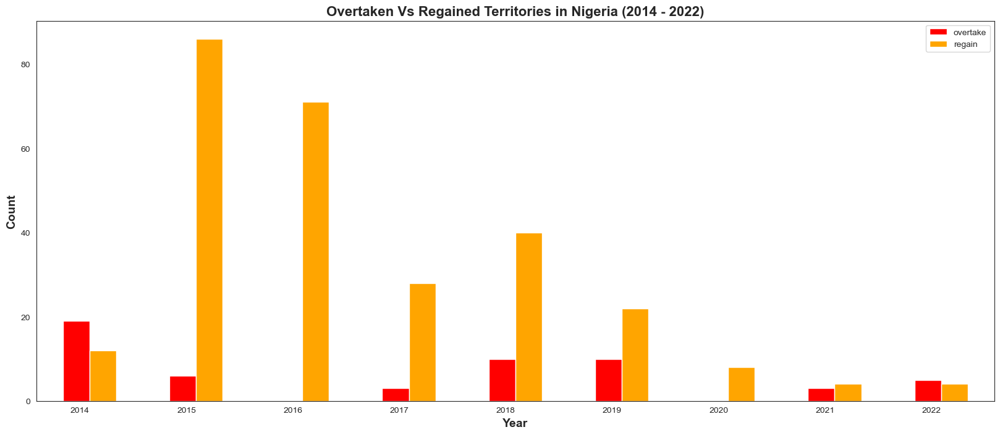

In [309]:
# Create a grouped bar chart of regained territory Versus Overtaken Territory by year

# First, merge the two data frames
nga_regain_overtake_agg_yr = pd.merge( nga_overtake_tertry_agg_yr, nga_regain_tertry_agg_yr, on="year", how="right")

nga_regain_overtake_agg_yr.rename(columns={"regain_x": "overtake", "regain_y": "regain"}, inplace=True)
nga_regain_overtake_agg_yr.fillna(0, inplace=True)

nga_regain_overtake_agg_yr.head(11)

# Make a group bar chart
fig1, ax1 = plt.subplots(1, figsize=(20, 8))

nga_regain_overtake_agg_yr.plot(
    "year", 
    kind="bar",
    stacked=False,
    color=["red", "orange"],
    ax=ax1,
    )

# Add title and axis labels in bold font
ax1.set_title("Overtaken Vs Regained Territories in Nigeria (2014 - 2022)", fontsize=16, fontweight="bold")
ax1.set_xlabel("Year", fontsize=14, fontweight="bold")
ax1.set_ylabel("Count", fontsize=14, fontweight="bold")

# Rotate the x-axis labels
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=0, ha="right");

fig1.savefig("Maps_Images/Overtaken_and_Regained_Territory_Python_Bar.png", transparent=True)

## Load and Display Multi-Temporal Satellite Images of Two of The Overtaken (Now Regained) Towns in Borno State

In [4]:
# Display the images of "NEW MARTE" town  
new_marte = f"""
<table>
  <tr>
    <td style="text-align:center;">
      <img src="Maps_Images/New_Marte_Jan_2013.png" style="width:1800px;">
      <p style="font-size:14px;">New Marte - Jan 2013</p>
    </td>
    <td style="text-align:center;">
      <img src="Maps_Images/New_Marte_Dec_2016.png" style="width:1800px;">
      <p style="font-size:14px;">New Marte - Dec 2016</p>
    </td>
    <td style="text-align:center;">
      <img src="Maps_Images/New_Marte_May_2023.png" style="width:1800px;">
      <p style="font-size:14px;">New Marte - May 2023</p>
    </td>
  </tr>
</table>
"""

display(HTML(new_marte))

# Display the images of "NGURO SOYE" town  
nguro_soye = f"""
<table>
  <tr>
    <td style="text-align:center;">
      <img src="Maps_Images/Nguro_Soye_Oct_2014.png" style="width:1800px;">
      <p style="font-size:14px;">Nguro Soye - Oct 2014</p>
    </td>
    <td style="text-align:center;">
      <img src="Maps_Images/Nguro_Soye_March_2019.png" style="width:1800px;">
      <p style="font-size:14px;">Nguro Soye - March 2019</p>
    </td>
    <td style="text-align:center;">
      <img src="Maps_Images/Nguro_Soye_Feb_2023.png" style="width:1800px;">
      <p style="font-size:14px;">Nguro Soye - February 2023</p>
    </td>
  </tr>
</table>
"""

display(HTML(nguro_soye))


New Marte - Jan 2013,New Marte - Dec 2016,New Marte - May 2023


Nguro Soye - Oct 2014,Nguro Soye - March 2019,Nguro Soye - February 2023


'New Marte - Jan 2013'

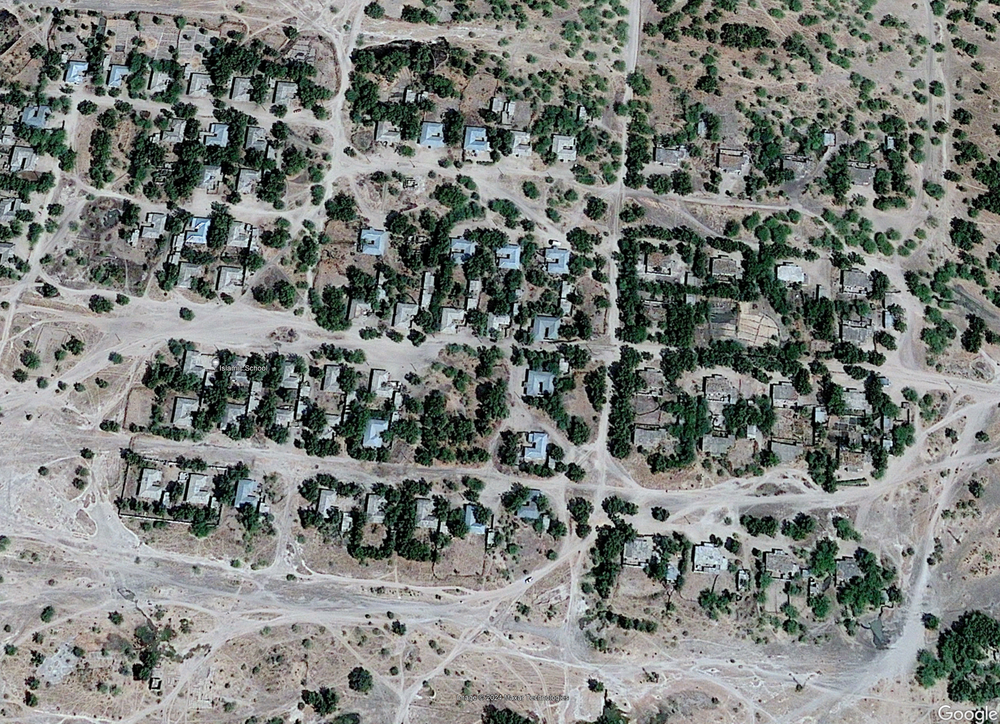

'New Marte - Dec 2016'

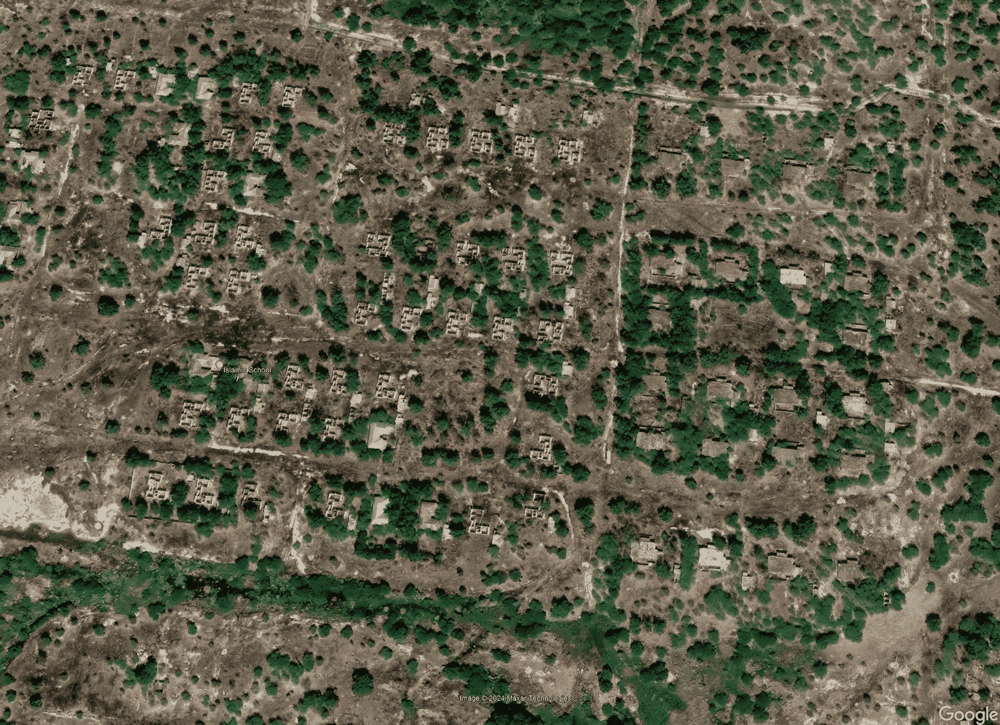

'New Marte - May 2023'

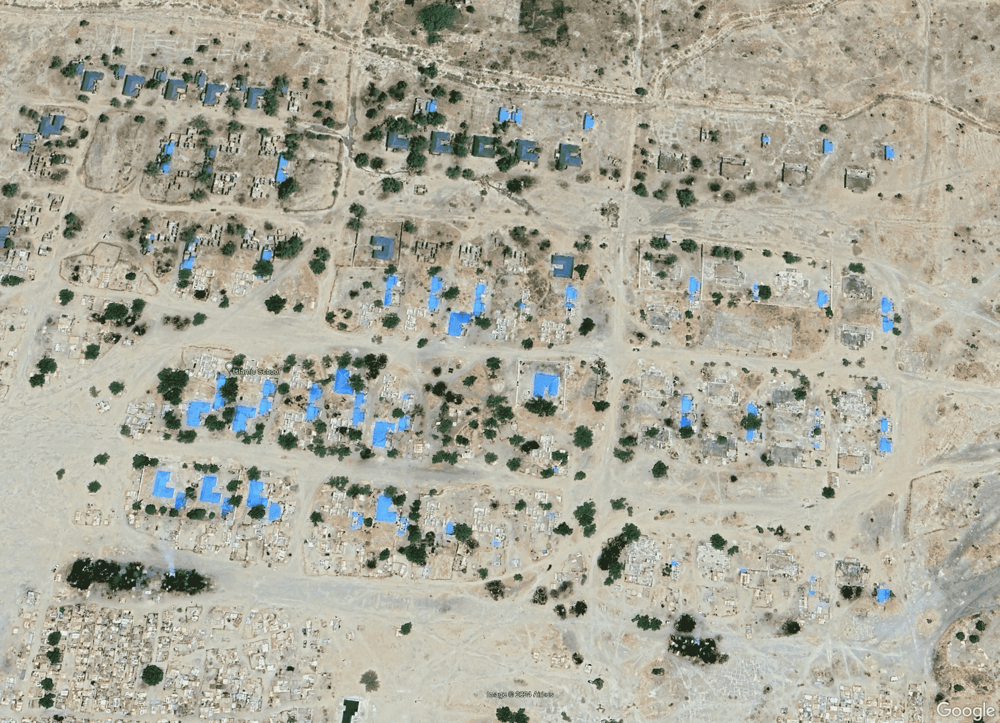

In [5]:
# Display the images of "NEW MARTE" town in a clearer way
img1= Image(filename="Maps_Images/New_Marte_Jan_2013.png") 
img2= Image(filename="Maps_Images/New_Marte_Dec_2016.png") 
img3= Image(filename="Maps_Images/New_Marte_May_2023.png") 

# Display images vertically
display("New Marte - Jan 2013", img1, "New Marte - Dec 2016", img2, "New Marte - May 2023", img3)



'Nguro Soye- Oct 2014.png'

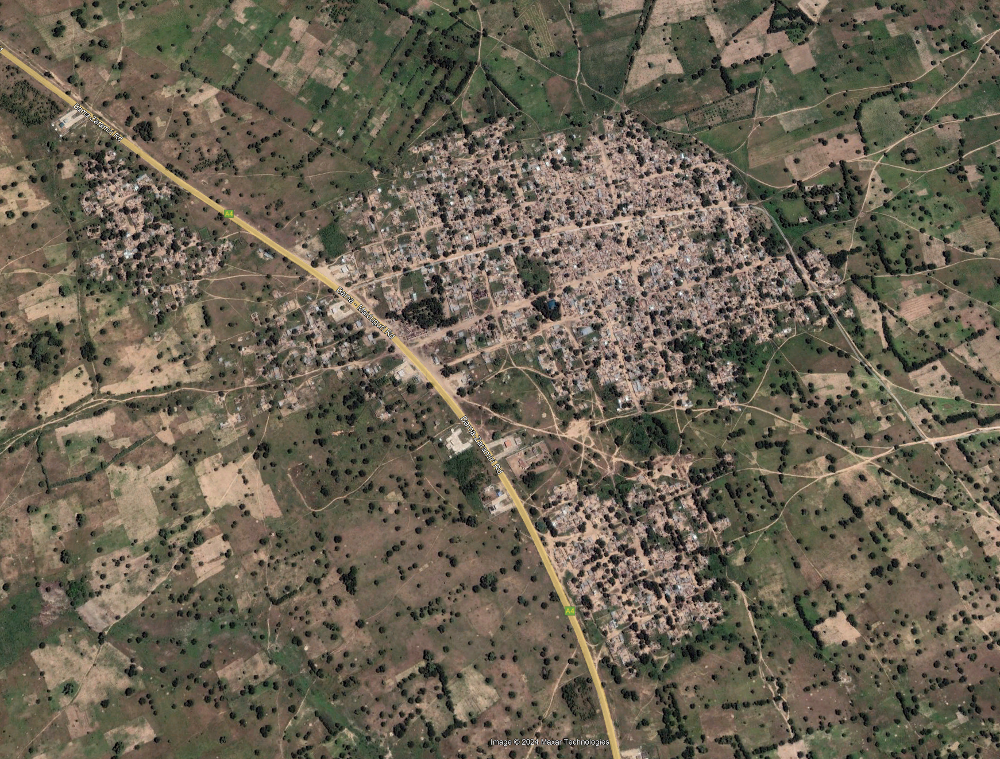

'Nguro Soye - March 2019.png'

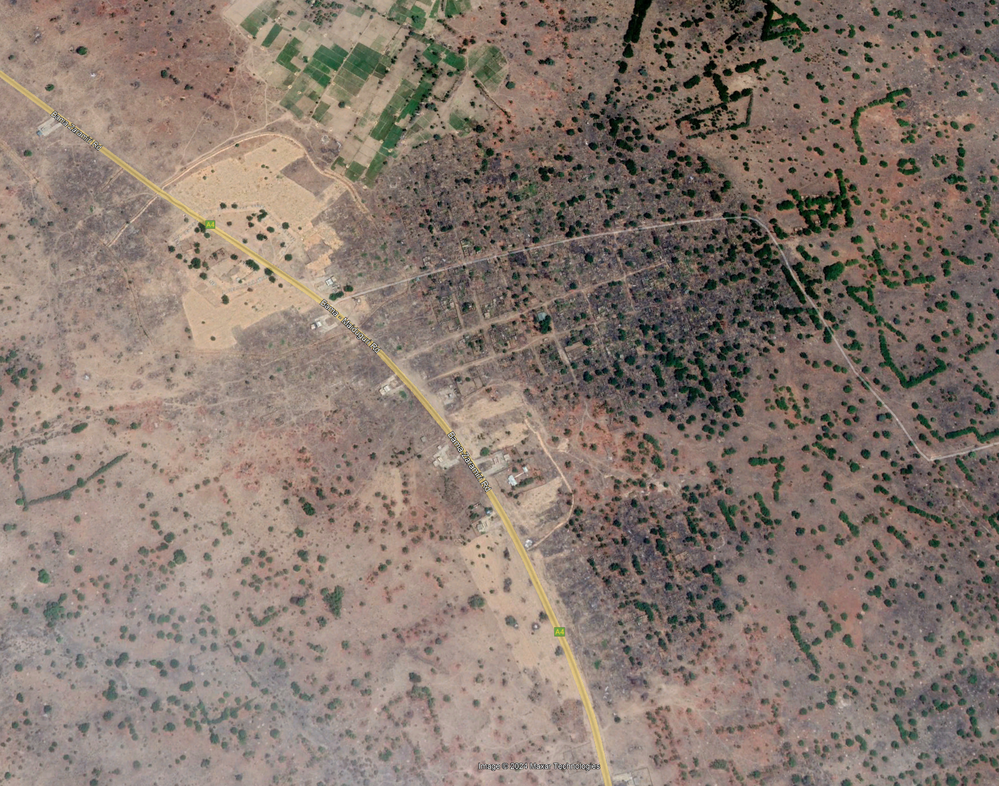

'Nguro Soye - Feb 2023.png'

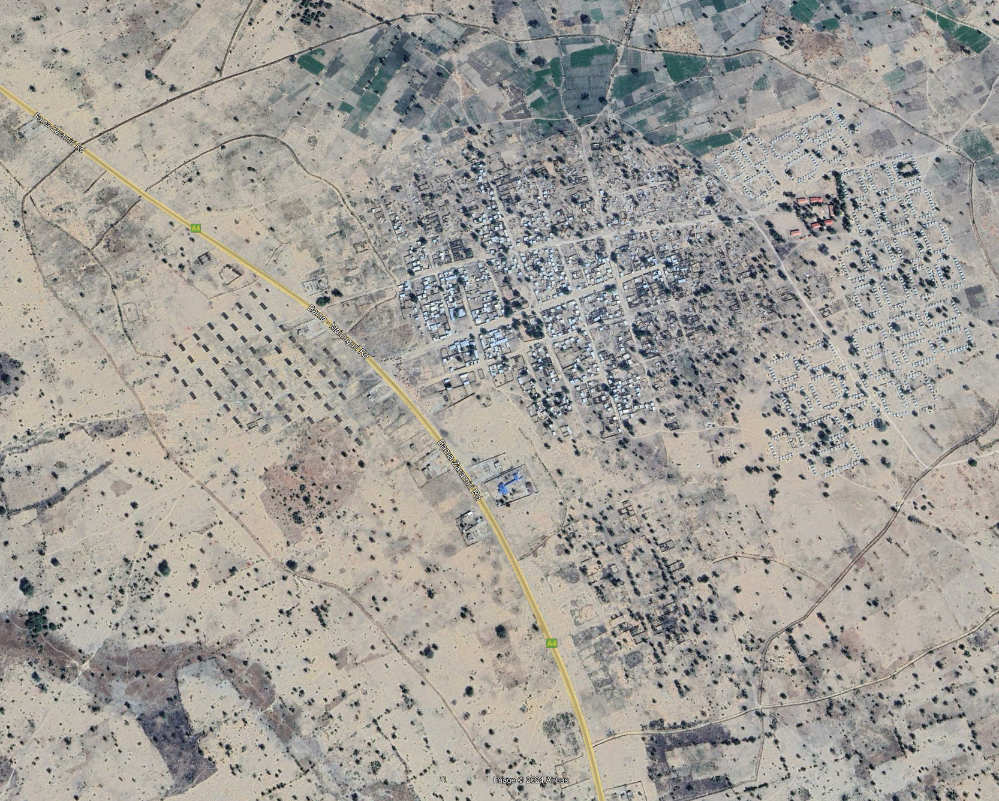

In [8]:
# Display the images of "NEW MARTE" town in a clearer way
img4= Image(filename="Maps_Images/Nguro_Soye_Oct_2014.png") 
img5= Image(filename="Maps_Images/Nguro_Soye_March_2019.png") 
img6= Image(filename="Maps_Images/Nguro_Soye_Feb_2023.png") 

# Display images vertically
display("Nguro Soye- Oct 2014.png", img4, "Nguro Soye - March 2019.png", img5, "Nguro Soye - Feb 2023.png", img6)